# Assignment 2 - Machine Learning
## FEUP MIEIC - Inteligência Artificial *(EIC0029/IART)*



## Data pre-processing partial notebook

This Jupyter Notebook implpementes and documents our approach to extract, maipulate, and in essence pre-process the data that will be used to train and test our machine learning models. <br><br>
*The content of this notebook will be also included in the complete notebook named **IART-MachineLearning.ipynb** that can be found in the root directory of this repository*

***

In [5]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
import sqlite3
from sklearn.model_selection import train_test_split
from sklearn import preprocessing

In [6]:
# Connecting to database
database = "database.sqlite"
con = sqlite3.connect(database)
pd.set_option('display.max_columns', None)

In [7]:
#Get important tables from db
matches_df = pd.read_sql("""SELECT * from MATCH""", con)
teams_df = pd.read_sql("""SELECT * from TEAM""", con)
player_attributes_df = pd.read_sql("""SELECT * from PLAYER_ATTRIBUTES""", con)
team_attributes_df = pd.read_sql("""SELECT * from TEAM_ATTRIBUTES""", con)

In [8]:
#Get players' attributes (overall)

#Get players info
home_players = ["home_player_" + str(x) for x in range(1, 12)]
away_players = ["away_player_" + str(x) for x in range(1, 12)]

matches_kept_columns = ["id", "league_id", "date", "home_team_api_id", "away_team_api_id", "home_team_goal", "away_team_goal"]
matches_kept_columns = matches_kept_columns + home_players
matches_kept_columns = matches_kept_columns + away_players

matches_df = matches_df[matches_kept_columns]

#Get overall ratings for all players from player_attributes table
for player in home_players:
    matches_df = pd.merge(matches_df, player_attributes_df[["id", "overall_rating"]], left_on=[player], right_on=["id"], suffixes=["", "_" + player])
for player in away_players:
    matches_df = pd.merge(matches_df, player_attributes_df[["id", "overall_rating"]], left_on=[player], right_on=["id"], suffixes=["", "_" + player])
 

matches_df = matches_df.rename(columns={"overall_rating": "overall_rating_home_player_1"})

matches_df['overall_rating_home'] = matches_df[['overall_rating_' + p for p in home_players]].sum(axis=1)
matches_df['overall_rating_away'] = matches_df[['overall_rating_' + p for p in away_players]].sum(axis=1)
matches_df['overall_rating_difference'] = matches_df['overall_rating_home'] - matches_df['overall_rating_away']

matches_df['mean_overall_rating_home'] = matches_df[['overall_rating_' + p for p in home_players]].mean(axis=1)
matches_df['mean_overall_rating_away'] = matches_df[['overall_rating_' + p for p in away_players]].mean(axis=1)


#Remove all players column because we just need the "global" ones
for c in matches_df.columns:
    if '_player_' in c:
        matches_df = matches_df.drop(c, axis=1)


In [18]:
#function to calculate last 5 games performance
def last5(team_id, date, match_t):
     
    mat = match_t[(match_t['date'] < date)]
    mat = mat[mat['home_team_api_id'] == team_id]
    
    mat5 = mat.head(5)
    if len(mat5.index) < 5:
        return 0
    mat5['Home result'] = 0
    mat5['Home result'] = np.where(mat5['home_team_goal'] > mat5['away_team_goal'], 3, mat5['Home result'])
    mat5['Home result'] = np.where(mat5['home_team_goal'] == mat5['away_team_goal'], 1, mat5['Home result'])
    total = mat5['Home result'].sum()
    return total

match_t = matches_df[['home_team_api_id', 'away_team_api_id','date', 'home_team_goal', 'away_team_goal']].copy()
match_t['date'] = pd.to_datetime(match_t['date'])
match_t.sort_values(by=['date'], inplace=True, ascending=False) 
matches_df['Home_last5'] = 0
matches_df['Away_last5'] = 0
perc = 0
for i in matches_df.index:
    Htotal = last5(match_t['home_team_api_id'].iloc[i], match_t['date'].iloc[i], match_t)
    Atotal = last5(match_t['away_team_api_id'].iloc[i], match_t['date'].iloc[i], match_t)
    matches_df['Home_last5'].values[i] = Htotal
    matches_df['Away_last5'].values[i] = Atotal
    if i % 655 == 0:
        perc += 10
        print(perc, "%", end=" ")

matches_df

KeyError: "None of [Index(['home_team_api_id', 'away_team_api_id', 'date', 'home_team_goal',\n       'away_team_goal'],\n      dtype='object')] are in the [columns]"

In [10]:
matches_aux = pd.read_sql("""SELECT * FROM MATCH""" ,con)

#Select all bet columns (removed PSA, PSH, PSD because they are almost all NaN)
bet_columns = ["B365H", "B365A", "B365D", "BWH", "BWD", "BWA", "IWH", "IWD", "IWA", "LBH", "LBD", "LBA", "WHH", "WHD", "WHA", "SJH", "SJD", "SJA", "VCH", "VCD", "VCA", "GBH", "GBD", "GBA", "BSH", "BSD", "BSA"]

#Get specific columns for bets on home and draw
bet_columns_home = ["B365H", "BWH","IWH", "LBH", "WHH", "SJH", "VCH", "GBH","BSH"]
bet_columns_draw = ["B365D", "BWD","IWD", "LBD", "WHD", "SJD", "VCD", "GBD","BSD"]

#Calculate mean values for bets on home team and draw. Add these values to match table
matches_df['mean_bets_home'] = matches_aux[bet_columns_home].mean(axis=1)
matches_df['mean_bets_draw'] = matches_aux[bet_columns_draw].mean(axis=1)

In [11]:
#Replace NaN values (on bets) with mean values 
matches_df.fillna(matches_df.mean(), inplace=True)
matches_df.isnull().sum()

id                           0
league_id                    0
date                         0
home_team_api_id             0
away_team_api_id             0
home_team_goal               0
away_team_goal               0
overall_rating_home          0
overall_rating_away          0
overall_rating_difference    0
mean_overall_rating_home     0
mean_overall_rating_away     0
Home_last5                   0
Away_last5                   0
mean_bets_home               0
mean_bets_draw               0
dtype: int64

In [12]:
#Get goal difference
matches_df['goal_diff'] = matches_df['home_team_goal'] - matches_df['away_team_goal']

matches_df['Game Result'] = 'Defeat'
matches_df['Game Result'] = np.where(matches_df['goal_diff'] == 0, 'Draw', matches_df['Game Result'])
matches_df['Game Result'] = np.where(matches_df['goal_diff'] > 0, 'Win', matches_df['Game Result'])


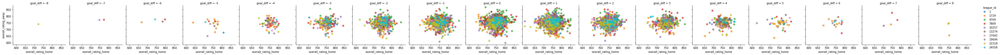

In [13]:
h = sns.FacetGrid(matches_df, col="goal_diff", hue="league_id")
h.map(plt.scatter, "overall_rating_home", "overall_rating_away", alpha=.7)
h.add_legend();

''

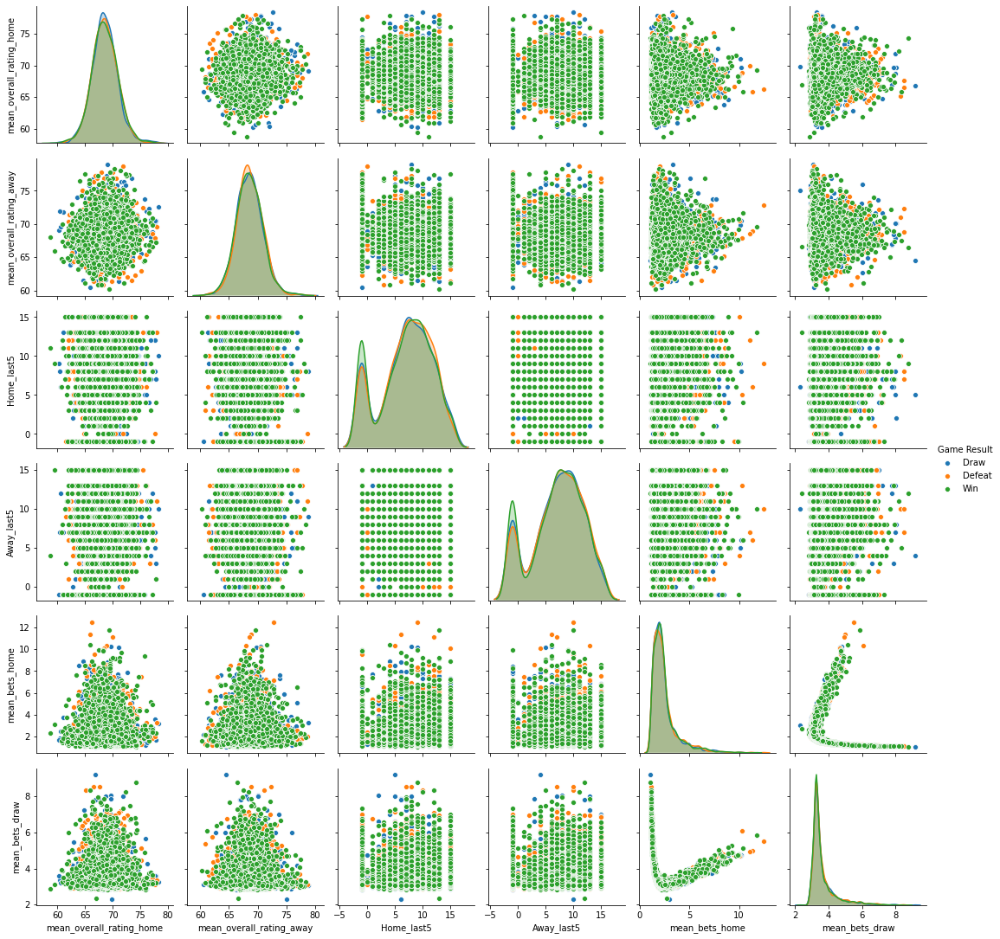

In [14]:
#plot varaiables
matches_df = matches_df.drop([ 'id', 'league_id', 'date', 'home_team_api_id','away_team_api_id','home_team_goal','away_team_goal','overall_rating_home', 'overall_rating_away', 'overall_rating_difference', 'goal_diff'], axis=1)
sns.pairplot(matches_df, hue='Game Result')
;

In [15]:
y = matches_df['Game Result']
X = matches_df.drop('Game Result', axis=1)
X

,mean_overall_rating_home,mean_overall_rating_away,Home_last5,Away_last5,mean_bets_home,mean_bets_draw
0,67.818182,71.181818,1,1,1.765556,3.322222
1,70.181818,71.818182,8,11,1.898889,3.250000
2,70.909091,71.900000,9,8,2.462222,3.233333
3,68.800000,71.700000,8,3,1.438889,3.805556
4,66.636364,70.000000,8,-1,4.494444,3.422222
...,...,...,...,...,...,...
6537,70.181818,70.909091,-1,-1,2.044444,3.144444
6538,68.636364,65.454545,-1,-1,2.284444,3.097778
6539,68.363636,70.818182,-1,-1,2.282222,3.066667
6540,68.200000,68.636364,-1,-1,2.515556,3.100000


In [16]:
#Train set selection
X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    test_size=0.3, 
                                                    random_state=42, 
                                                    stratify=y)

In [17]:
#Normalization
scaler = preprocessing.StandardScaler().fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_train_scaled

array([[ 0.40273464,  0.05329323, -0.45302195, -0.46402258, -0.80409666,
         0.79908931],
       [ 0.16776826, -1.88681991, -0.88649547,  0.1898166 ,  1.83238381,
         0.19300915],
       [-0.22384238, -0.10508335, -1.7534425 ,  1.27954857, -0.3775066 ,
        -0.11298022],
       ...,
       [-0.4196477 , -0.26345993,  1.06413536,  0.1898166 , -0.39374951,
        -0.72127234],
       [ 0.28525145,  1.16192932,  0.19718832, -1.77170094,  0.51670824,
        -0.44846254],
       [ 1.8477779 ,  1.55787078,  0.8473986 , -0.24607618,  0.55004895,
        -0.55168787]])